In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import glob
import random
from PIL import Image
import time
import datetime

import tensorflow as tf
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.losses import mean_squared_error
from tensorflow.keras.optimizers import Adam

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Preprocessing and loading of data

In [3]:
#ls drive/MyDrive/reside/archive/clear_images drive/MyDrive/reside/archive/haze  

In [4]:
# function to load the image in the form of tensors.

def load_image(img_path):
    img = tf.io.read_file(img_path)
    img = tf.io.decode_jpeg(img, channels = 3)
    img = tf.image.resize(img, size = (412, 548), antialias = True)
    img = img / 255.0
    return img

In [5]:
# function to get the path of individual image.

def data_path(orig_img_path, hazy_img_path):
    
    train_img = []
    val_img = []
    
    orig_img = glob.glob(orig_img_path + '/*.jpg')
    n = len(orig_img)
    random.shuffle(orig_img)
    train_keys = orig_img[:int(0.9*n)]        #90% data for train, 10% for test
    val_keys = orig_img[int(0.9*n):]
    
    split_dict = {}
    for key in train_keys:
        split_dict[key] = 'train'
    for key in val_keys:
        split_dict[key] = 'val'
        
    hazy_img = glob.glob(hazy_img_path + '/*.jpg')
    for img in hazy_img:
        img_name = img.split('/')[-1]
        orig_path = orig_img_path + '/' + img_name.split('_')[0] + '.jpg'
        if (split_dict[orig_path] == 'train'):
            train_img.append([img, orig_path])
        else:
            val_img.append([img, orig_path])
            
    return train_img, val_img

In [6]:
# function to load tensor image data in batches.

def dataloader(train_data, val_data, batch_size):
    
    train_data_orig = tf.data.Dataset.from_tensor_slices([img[1] for img in train_data]).map(lambda x: load_image(x))
    train_data_haze = tf.data.Dataset.from_tensor_slices([img[0] for img in train_data]).map(lambda x: load_image(x))
    train = tf.data.Dataset.zip((train_data_haze, train_data_orig)).shuffle(buffer_size=100).batch(batch_size)
    
    val_data_orig = tf.data.Dataset.from_tensor_slices([img[1] for img in val_data]).map(lambda x: load_image(x))
    val_data_haze = tf.data.Dataset.from_tensor_slices([img[0] for img in val_data]).map(lambda x: load_image(x))
    val = tf.data.Dataset.zip((val_data_haze, val_data_orig)).shuffle(buffer_size=100).batch(batch_size)
    
    return train, val

In [7]:
# function to display output.
import cv2
def display_img(model, hazy_img, orig_img):
    
    dehazed_img = model(hazy_img, training = True)
    plt.figure(figsize = (15,15))
    
    display_list = [hazy_img[0], orig_img[0], dehazed_img[0]]
    title = ['Hazy Image', 'Ground Truth', 'Dehazed Image']
    
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
        
    plt.show()
    #print("input image quality",display_list)#niqe(cv2.imread(display_list[1])))
    #print("input image quality",niqe(cv2.imread(display_list[2])))

# Network Function

In [8]:
class smoothDilateRes(tf.keras.Model):
  def __init__(self, channel_num, dilation=1, group=1):
        super(smoothDilateRes, self).__init__()
        #self.pre_conv1 = ShareSepConv(dilation*2-1)
        #self.conv1 = nn.Conv2d(channel_num, 3, 1, padding=dilation, dilation=dilation, groups=group, bias=False)
        self.conv1 = tf.keras.layers.Conv2D(channel_num,3,1,padding='same',dilation_rate=dilation,groups=group,use_bias=False)
        self.norm1 = tf.keras.layers.BatchNormalization()
        #self.pre_conv2 = ShareSepConv(dilation*2-1)
        self.relu= tf.keras.layers.ReLU()               

  def call(self, x):
        y=self.conv1(x)
        y=self.norm1(y)
        y=self.relu(y)
        #y = F.relu(self.norm1(self.conv1(self.pre_conv1(x))))
        y=self.conv1(x)
        y=self.norm1(y)
        y=self.relu(y)
        y = self.norm1(self.conv1(y))
        return self.relu(x+y)
        #return F.relu(x+y)

class ResBlock(tf.keras.Model):
    def __init__(self, channel_num, dilation=1, group=1):
        super(ResBlock, self).__init__()
        self.conv1 = tf.keras.layers.Conv2D(channel_num,3,1,padding='same',dilation_rate=dilation,groups=group,use_bias=False)
        self.norm1 = tf.keras.layers.BatchNormalization()
        #self.pre_conv2 = ShareSepConv(dilation*2-1)
        self.relu= tf.keras.layers.ReLU()               

    def call(self, x):
        y = self.relu(self.norm1(self.conv1(x)))
        y = self.norm1(self.conv1(y))
        return self.relu(x+y)

In [9]:
class GCA(tf.keras.Model):
    def __init__(self, in_c=3, out_c=3, only_residual=True):
        super(GCA, self).__init__()
        self.relu= tf.keras.layers.ReLU()
        self.conv1 = tf.keras.layers.Conv2D(64,3,strides=1,padding='same',use_bias=False)             
        self.norm1 = tf.keras.layers.BatchNormalization()
        self.conv2 = tf.keras.layers.Conv2D(64,3,strides=1,padding='same',use_bias=False)
        self.conv3 = tf.keras.layers.Conv2D(64,3,strides=2,padding='same',use_bias=False)

        self.res1 = smoothDilateRes(64, dilation=2)
        self.res2 = smoothDilateRes(64, dilation=2)
        self.res3 = smoothDilateRes(64, dilation=2)
        self.res4 = smoothDilateRes(64, dilation=4)
        self.res5 = smoothDilateRes(64, dilation=4)
        self.res6 = smoothDilateRes(64, dilation=4)
        self.res7 = ResBlock(64, dilation=1)

        self.gate = tf.keras.layers.Conv2D(3,3,1,padding='same',use_bias=True)
        #nn.ConvTranspose2d(64, 64, 4, 2, 1)
        self.deconv3 =tf.keras.layers.Conv2DTranspose(64,4,2,padding='same')
        self.deconv1 =tf.keras.layers.Conv2D(out_c,1
                                             )
        self.only_residual = only_residual
        
    def call(self, input_tensor, training=False):
        # forward pass: block 1 
        y = self.relu(self.norm1(self.conv1(input_tensor)))
        y = self.relu(self.norm1(self.conv2(y)))   
        y1=self.relu(self.norm1(self.conv3(y)))
        
        y = self.res1(y1)
        y = self.res2(y)
        y = self.res3(y)
        y2 = self.res4(y)
        y = self.res5(y2)
        y = self.res6(y)
        y3 = self.res7(y)
        #gates = self.gate(torch.cat((y1, y2, y3), dim=1))
       
        
        g=tf.keras.layers.Concatenate(axis=-1)([y1, y2,y3])
        gates = self.gate(g)
        #return gates
        g1=tf.expand_dims(gates[:,:,:,0],-1)
        g2=tf.expand_dims(gates[:,:,:,1],-1)
        g3=tf.expand_dims(gates[:,:,:,2],-1)
        gated_y = g1*y1+g2*y2+g3*y3
        y = self.relu(self.norm1(self.deconv3(gated_y)))
       
        y = self.relu(self.norm1(self.conv2(y)))
        if self.only_residual:
            y = self.deconv1(y)
        else:
            y = self.relu(self.deconv1(y))

        return y
        

    def model(self):
        x = Input(shape = (412, 548, 3))
        return Model(inputs=[x], outputs=self.call(x))


In [10]:
sub = GCA()
sub.model().summary()


Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 412, 548, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 412, 548, 64) 1728        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma multiple             256         conv2d[0][0]                     
                                                                 conv2d_1[0][0]                   
                                                                 conv2d_2[0][0]                   
                                                                 conv2d_transpose[0][0]       

In [14]:
# Hyperparameters
epochs = 60
batch_size = 8
k_init = tf.keras.initializers.random_normal(stddev=0.008, seed = 101)      
regularizer = tf.keras.regularizers.L2(1e-4)
b_init = tf.constant_initializer()

train_data, val_data = data_path(orig_img_path = './drive/MyDrive/reside/archive/clear_images', hazy_img_path = './drive/MyDrive/reside/archive/haze')
train, val = dataloader(train_data, val_data, batch_size)

optimizer = Adam(learning_rate = 1e-4)
net = GCA()

train_loss_tracker = tf.keras.metrics.MeanSquaredError(name = "train loss")
val_loss_tracker = tf.keras.metrics.MeanSquaredError(name = "val loss")

In [15]:
def train_model(epochs, train, val, net, train_loss_tracker, val_loss_tracker, optimizer):
    
    for epoch in range(epochs):
        
        print("\nStart of epoch %d" % (epoch,), end=' ')
        start_time_epoch = time.time()
        start_time_step = time.time()
        
        # training loop
        
        for step, (train_batch_haze, train_batch_orig) in enumerate(train):

            with tf.GradientTape() as tape:

                train_logits = net(train_batch_haze, training = True)
                #print(train_logits.shape)
                loss = mean_squared_error(train_batch_orig, train_logits)

            grads = tape.gradient(loss, net.trainable_weights)
            optimizer.apply_gradients(zip(grads, net.trainable_weights))

            train_loss_tracker.update_state(train_batch_orig, train_logits)
            if step == 0:
                print('[', end='')
            if step % 64 == 0:
                print('=', end='')
        
        print(']', end='')
        print('  -  ', end='')
        print('Training Loss: %.4f' % (train_loss_tracker.result()), end='')
        
        # validation loop
        
        for step, (val_batch_haze, val_batch_orig) in enumerate(val):
            val_logits = net(val_batch_haze, training = False)
            val_loss_tracker.update_state(val_batch_orig, val_logits)
            
            if step % 32 ==0:
                display_img(net, val_batch_haze, val_batch_orig)
        
        print('  -  ', end='')
        print('Validation Loss: %.4f' % (val_loss_tracker.result()), end='')
        print('  -  ', end=' ')
        print("Time taken: %.2fs" % (time.time() - start_time_epoch))
        
        net.save('trained_model')           # save the model(variables, weights, etc)
        train_loss_tracker.reset_states()
        val_loss_tracker.reset_states()


Start of epoch 0 [==]  -  Training Loss: 0.5295

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


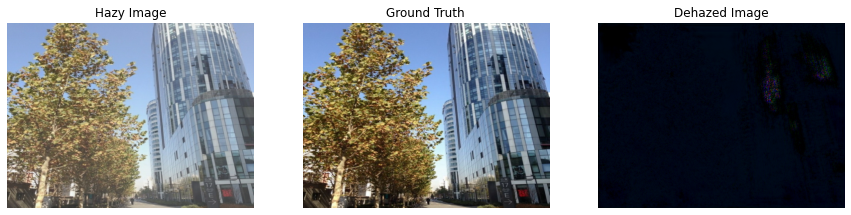

  -  Validation Loss: 0.3228  -   Time taken: 85.29s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 1 [==]  -  Training Loss: 0.2553

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


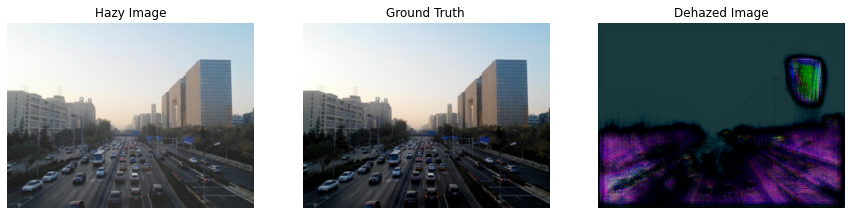

  -  Validation Loss: 0.3083  -   Time taken: 85.43s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 2 [==]  -  Training Loss: 0.0940

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


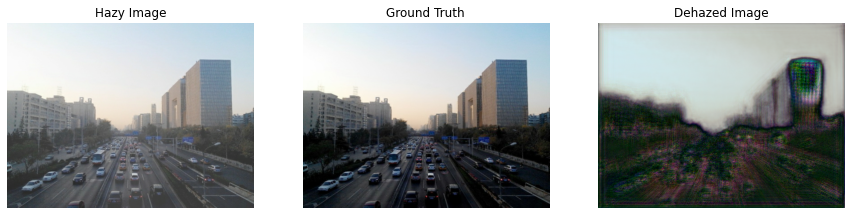

  -  Validation Loss: 0.3272  -   Time taken: 85.39s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 3 [==]  -  Training Loss: 0.0240

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


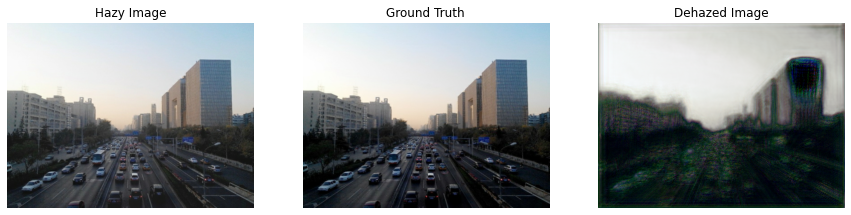

  -  Validation Loss: 0.3324  -   Time taken: 85.27s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 4 [==]  -  Training Loss: 0.0187

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


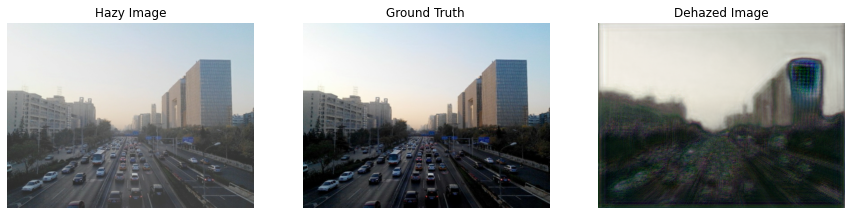

  -  Validation Loss: 0.3339  -   Time taken: 85.17s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 5 [==]  -  Training Loss: 0.0164

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


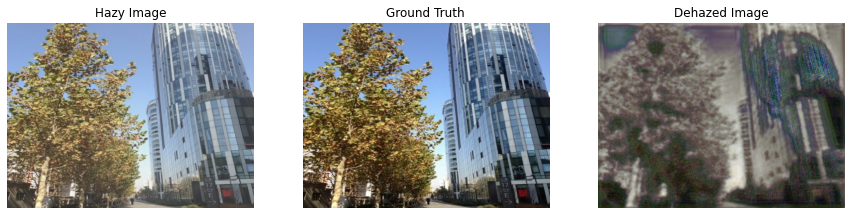

  -  Validation Loss: 0.3359  -   Time taken: 85.21s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 6 [==]  -  Training Loss: 0.0149

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


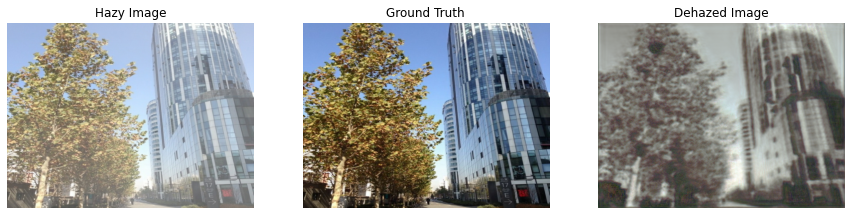

  -  Validation Loss: 0.3385  -   Time taken: 85.30s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 7 [==]  -  Training Loss: 0.0141

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


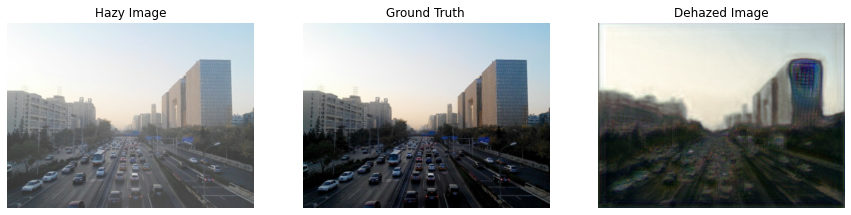

  -  Validation Loss: 0.3324  -   Time taken: 85.23s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 8 [==]  -  Training Loss: 0.0126

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


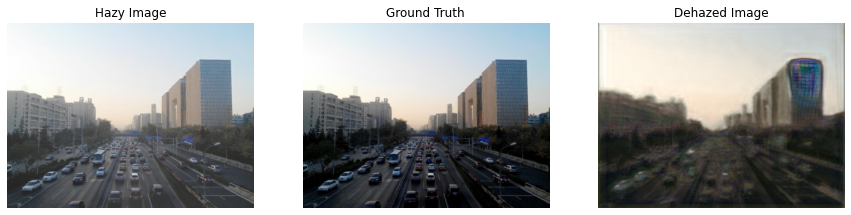

  -  Validation Loss: 0.3347  -   Time taken: 85.30s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 9 [==]  -  Training Loss: 0.0125

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


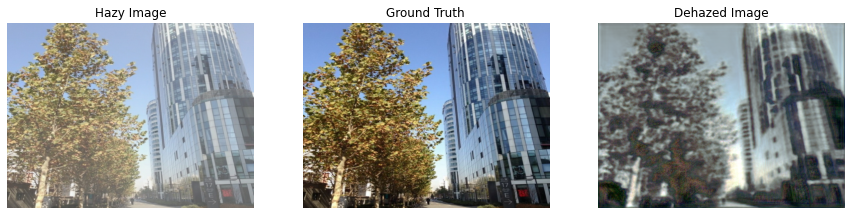

  -  Validation Loss: 0.3278  -   Time taken: 85.31s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 10 [==]  -  Training Loss: 0.0115

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


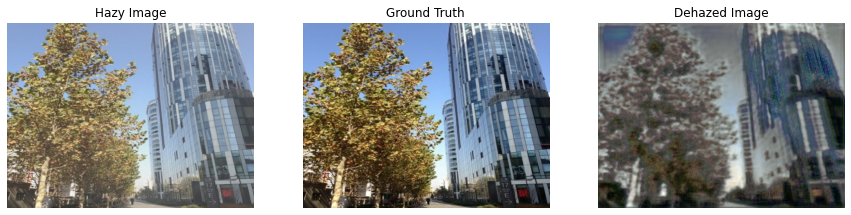

  -  Validation Loss: 0.3347  -   Time taken: 85.23s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 11 [==]  -  Training Loss: 0.0114

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


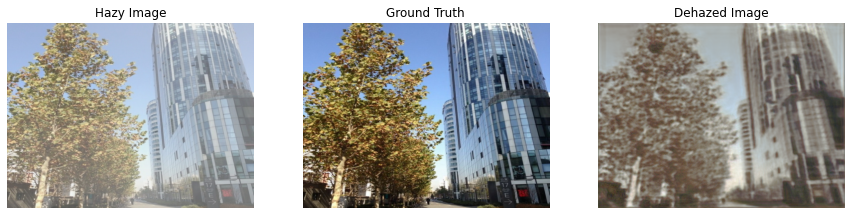

  -  Validation Loss: 0.3358  -   Time taken: 85.21s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 12 [==]  -  Training Loss: 0.0106

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


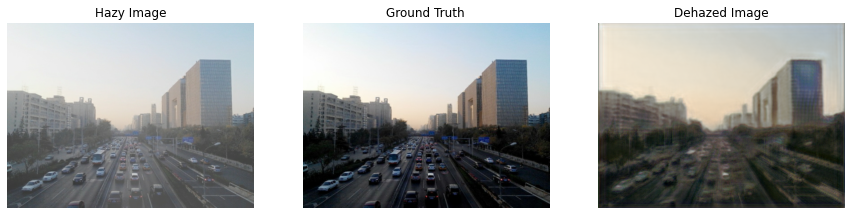

  -  Validation Loss: 0.3352  -   Time taken: 85.39s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 13 [==]  -  Training Loss: 0.0105

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


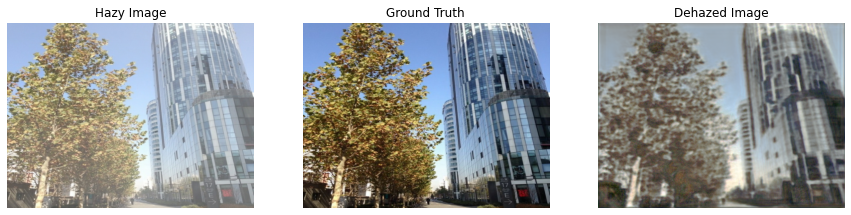

  -  Validation Loss: 0.3356  -   Time taken: 85.18s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 14 [==]  -  Training Loss: 0.0105

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


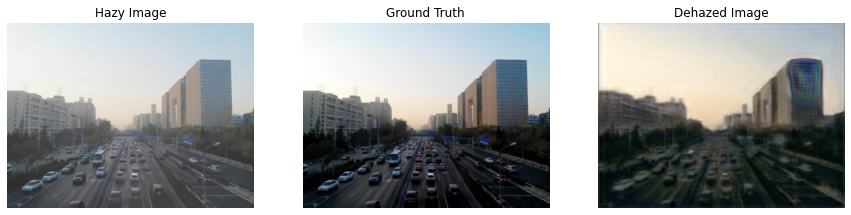

  -  Validation Loss: 0.3339  -   Time taken: 85.32s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 15 [==]  -  Training Loss: 0.0097

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


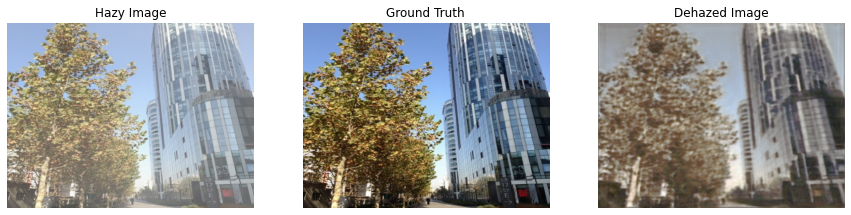

  -  Validation Loss: 0.3324  -   Time taken: 85.30s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 16 [==]  -  Training Loss: 0.0093

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


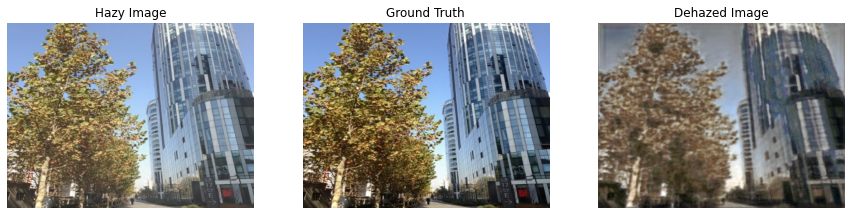

  -  Validation Loss: 0.3333  -   Time taken: 85.35s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 17 [==]  -  Training Loss: 0.0088

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


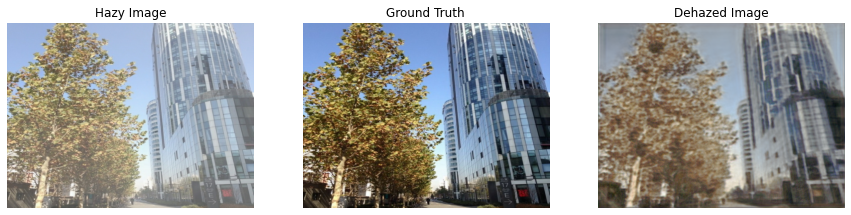

  -  Validation Loss: 0.3333  -   Time taken: 85.33s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 18 [==]  -  Training Loss: 0.0085

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


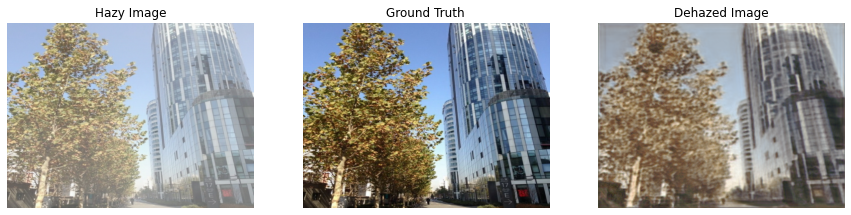

  -  Validation Loss: 0.3343  -   Time taken: 85.38s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 19 [==]  -  Training Loss: 0.0085

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


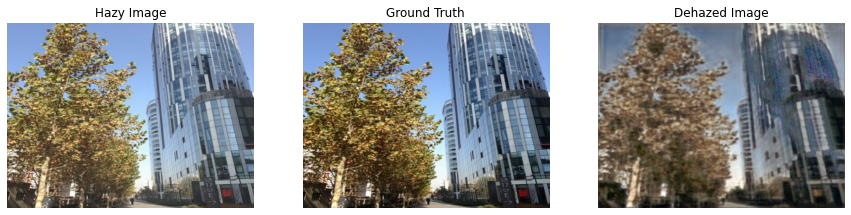

  -  Validation Loss: 0.3323  -   Time taken: 85.42s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 20 [==]  -  Training Loss: 0.0083

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


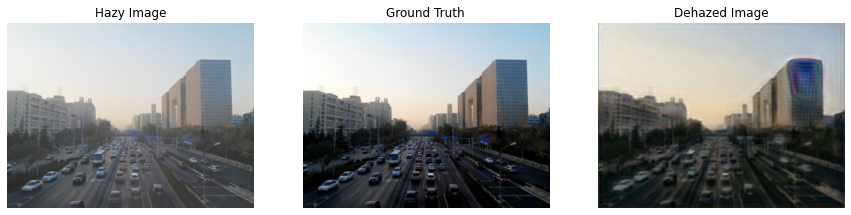

  -  Validation Loss: 0.3318  -   Time taken: 85.27s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 21 [==]  -  Training Loss: 0.0078

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


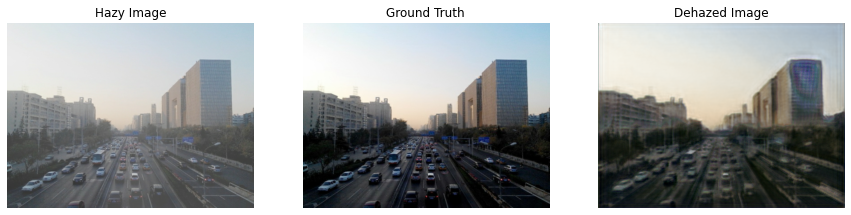

  -  Validation Loss: 0.3332  -   Time taken: 85.44s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 22 [==]  -  Training Loss: 0.0077

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


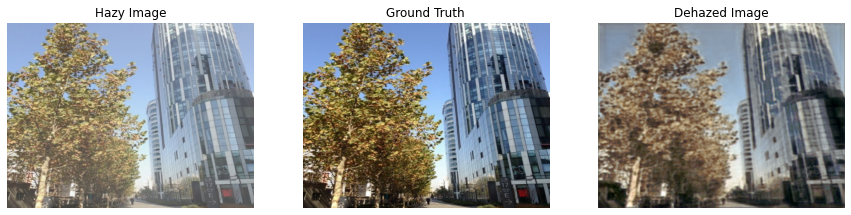

  -  Validation Loss: 0.3307  -   Time taken: 85.35s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 23 [==]  -  Training Loss: 0.0078

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


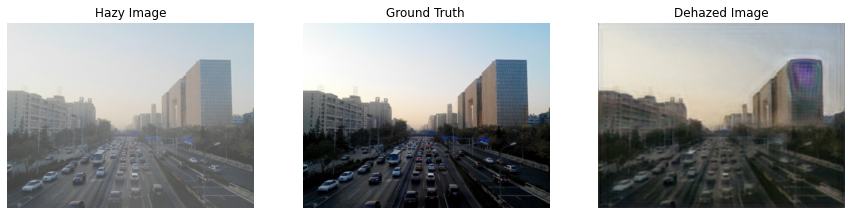

  -  Validation Loss: 0.3253  -   Time taken: 85.31s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 24 [==]  -  Training Loss: 0.0075

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


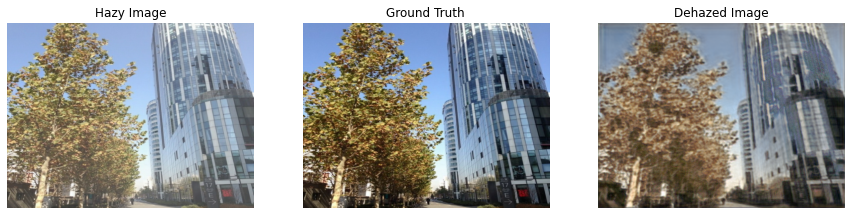

  -  Validation Loss: 0.3220  -   Time taken: 85.27s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 25 [==]  -  Training Loss: 0.0075

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


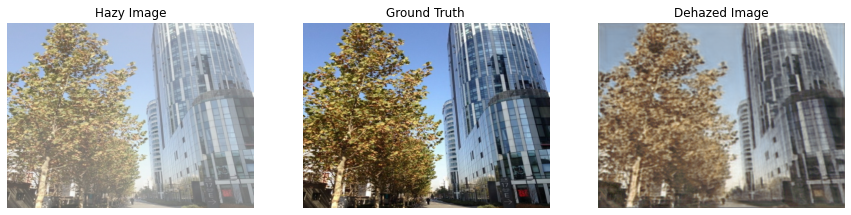

  -  Validation Loss: 0.3248  -   Time taken: 85.34s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 26 [==]  -  Training Loss: 0.0070

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


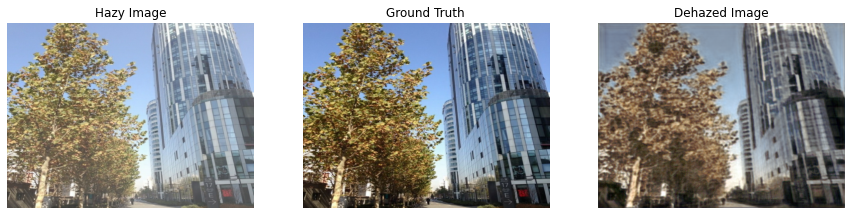

  -  Validation Loss: 0.3212  -   Time taken: 85.38s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 27 [==]  -  Training Loss: 0.0069

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


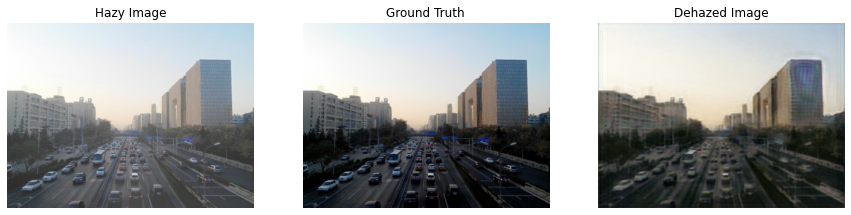

  -  Validation Loss: 0.3222  -   Time taken: 85.38s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 28 [==]  -  Training Loss: 0.0068

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


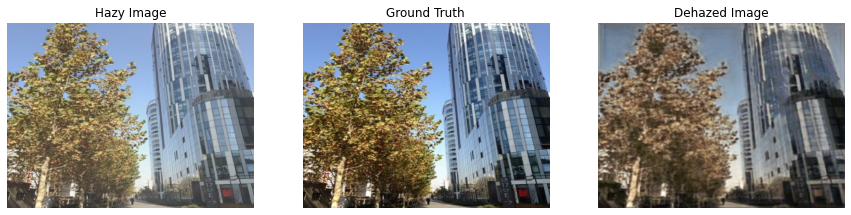

  -  Validation Loss: 0.3191  -   Time taken: 85.32s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 29 [==]  -  Training Loss: 0.0067

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


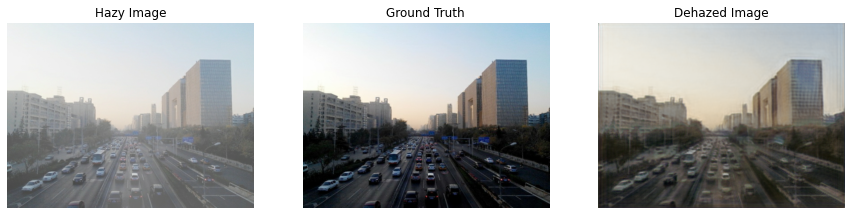

  -  Validation Loss: 0.3201  -   Time taken: 85.44s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 30 [==]  -  Training Loss: 0.0065

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


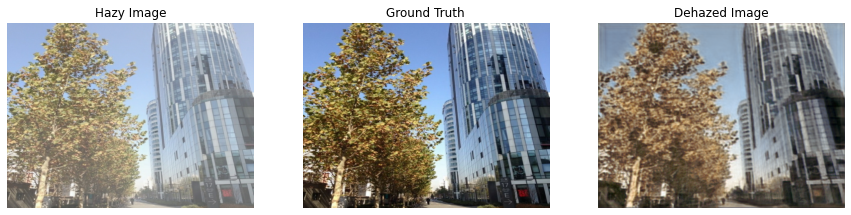

  -  Validation Loss: 0.3207  -   Time taken: 85.33s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 31 [==]  -  Training Loss: 0.0063

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


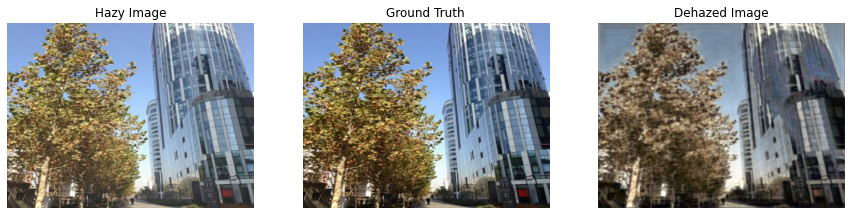

  -  Validation Loss: 0.3208  -   Time taken: 85.37s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 32 [==]  -  Training Loss: 0.0064

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


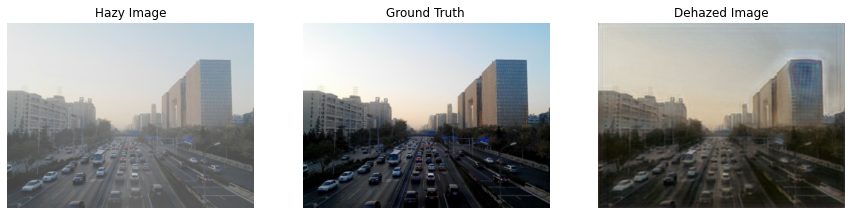

  -  Validation Loss: 0.3180  -   Time taken: 85.42s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 33 [==]  -  Training Loss: 0.0060

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


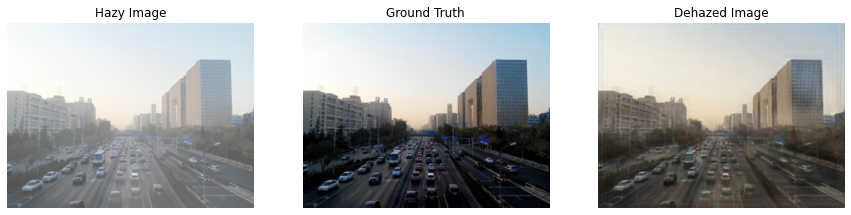

  -  Validation Loss: 0.3183  -   Time taken: 85.35s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 34 [==]  -  Training Loss: 0.0061

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


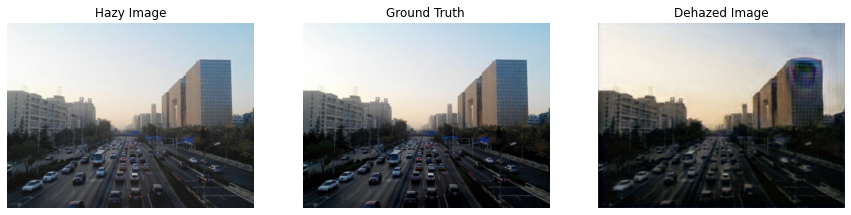

  -  Validation Loss: 0.3174  -   Time taken: 85.34s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 35 [==]  -  Training Loss: 0.0057

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


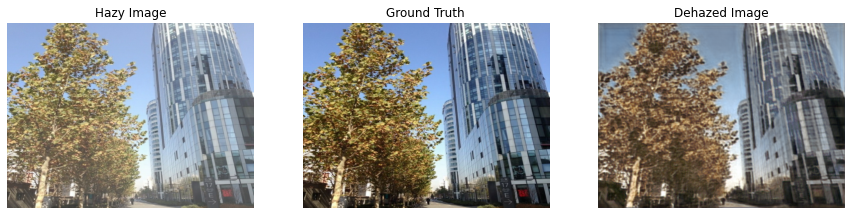

  -  Validation Loss: 0.3165  -   Time taken: 85.33s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 36 [==]  -  Training Loss: 0.0058

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


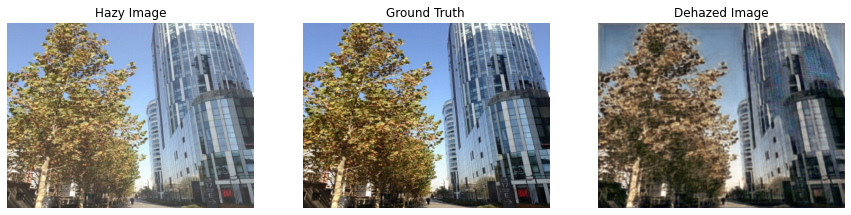

  -  Validation Loss: 0.3131  -   Time taken: 85.50s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 37 [==]  -  Training Loss: 0.0059

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


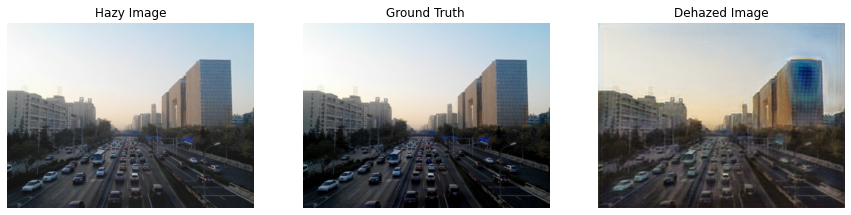

  -  Validation Loss: 0.3124  -   Time taken: 85.47s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 38 [==]  -  Training Loss: 0.0056

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


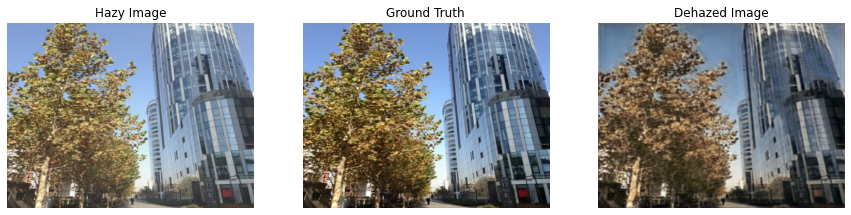

  -  Validation Loss: 0.3064  -   Time taken: 85.48s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 39 [==]  -  Training Loss: 0.0056

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


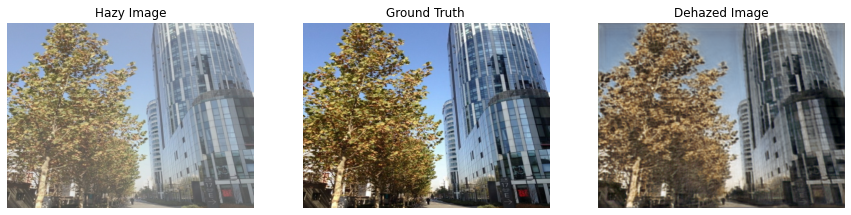

  -  Validation Loss: 0.3121  -   Time taken: 85.38s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 40 [==]  -  Training Loss: 0.0051

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


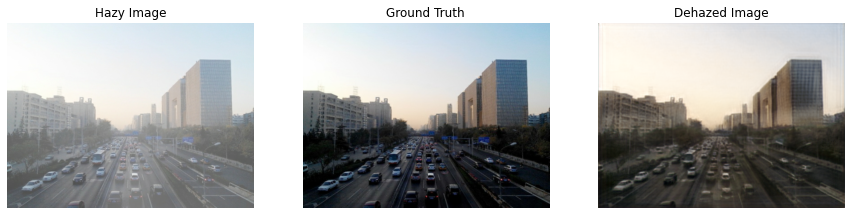

  -  Validation Loss: 0.3086  -   Time taken: 85.36s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 41 [==]  -  Training Loss: 0.0050

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


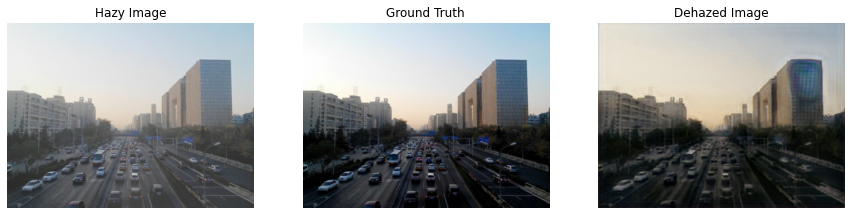

  -  Validation Loss: 0.3036  -   Time taken: 85.41s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 42 [==]  -  Training Loss: 0.0054

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


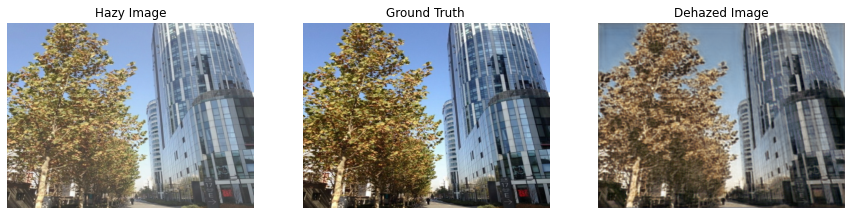

  -  Validation Loss: 0.3044  -   Time taken: 85.46s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 43 [==]  -  Training Loss: 0.0054

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


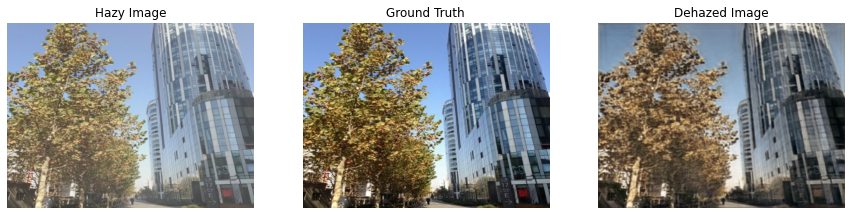

  -  Validation Loss: 0.3045  -   Time taken: 85.32s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 44 [==]  -  Training Loss: 0.0051

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


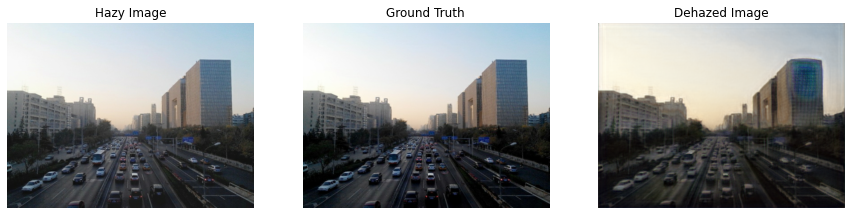

  -  Validation Loss: 0.3024  -   Time taken: 85.39s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 45 [==]  -  Training Loss: 0.0053

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


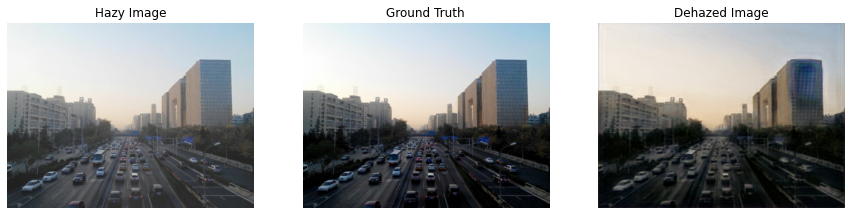

  -  Validation Loss: 0.3022  -   Time taken: 85.40s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 46 [==]  -  Training Loss: 0.0049

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


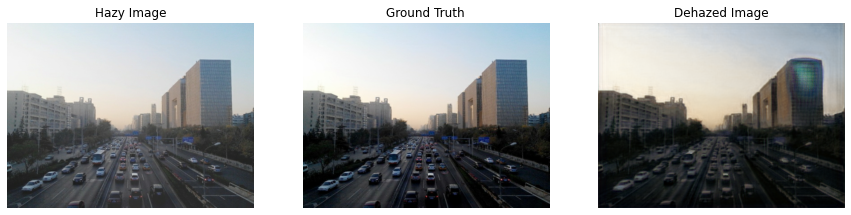

  -  Validation Loss: 0.3011  -   Time taken: 85.45s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 47 [==]  -  Training Loss: 0.0051

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


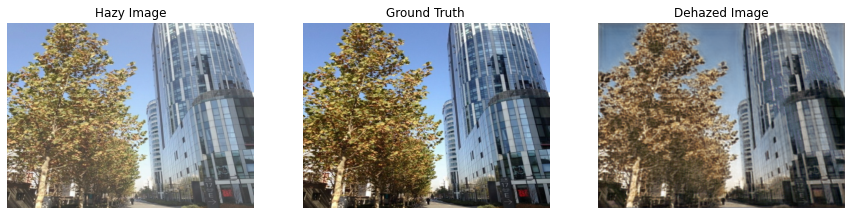

  -  Validation Loss: 0.3026  -   Time taken: 85.38s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 48 [==]  -  Training Loss: 0.0049

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


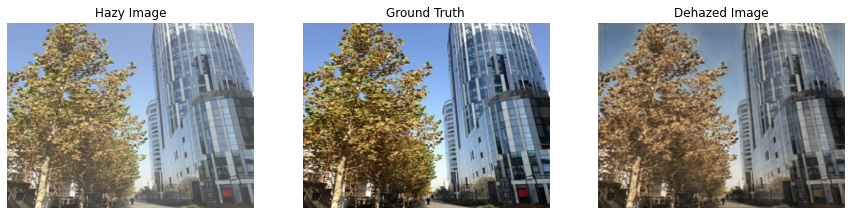

  -  Validation Loss: 0.3024  -   Time taken: 85.42s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 49 [==]  -  Training Loss: 0.0048

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


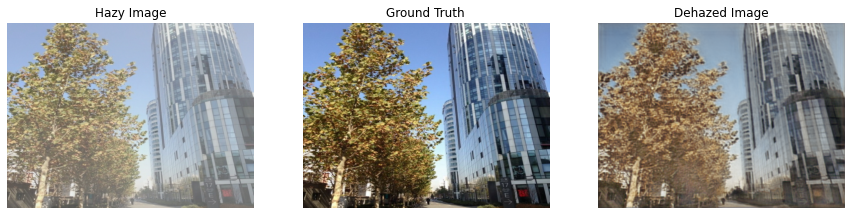

  -  Validation Loss: 0.2978  -   Time taken: 85.48s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 50 [==]  -  Training Loss: 0.0047

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


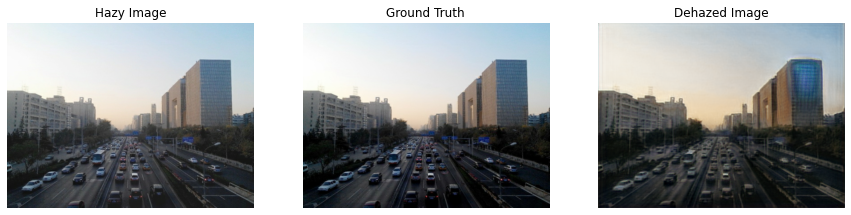

  -  Validation Loss: 0.2985  -   Time taken: 85.47s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 51 [==]  -  Training Loss: 0.0045

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


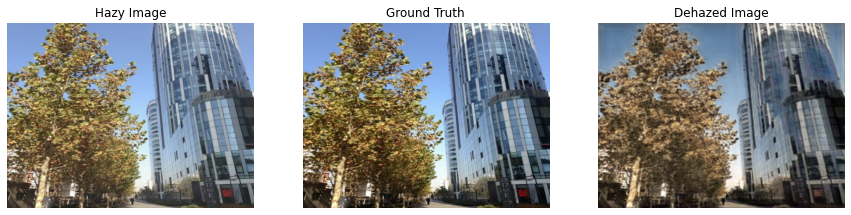

  -  Validation Loss: 0.2952  -   Time taken: 85.49s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 52 [==]  -  Training Loss: 0.0047

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


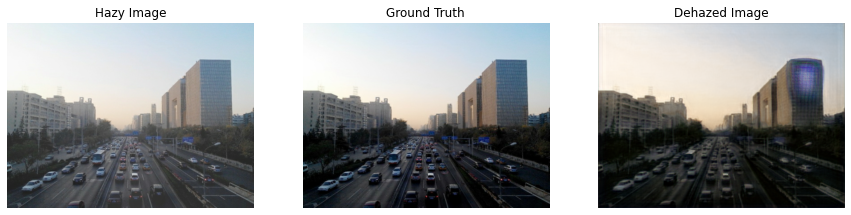

  -  Validation Loss: 0.2946  -   Time taken: 85.64s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 53 [==]  -  Training Loss: 0.0044

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


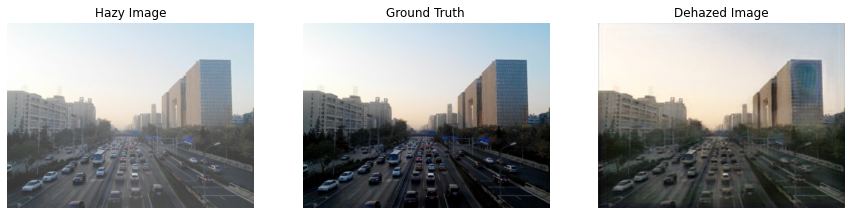

  -  Validation Loss: 0.2955  -   Time taken: 85.53s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 54 [==]  -  Training Loss: 0.0041

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


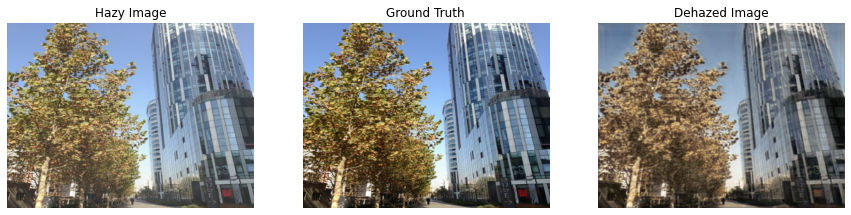

  -  Validation Loss: 0.2917  -   Time taken: 85.54s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 55 [==]  -  Training Loss: 0.0041

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


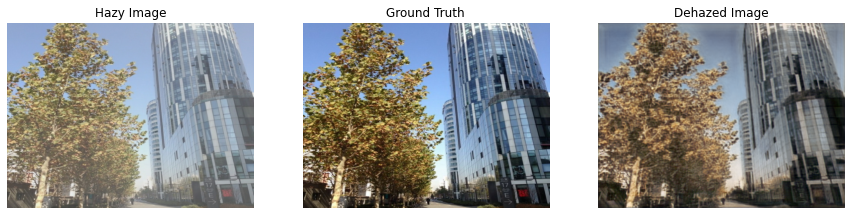

  -  Validation Loss: 0.2905  -   Time taken: 85.73s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 56 [==]  -  Training Loss: 0.0041

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


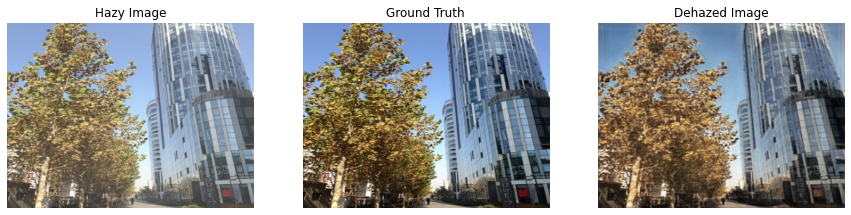

  -  Validation Loss: 0.2904  -   Time taken: 85.93s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 57 [==]  -  Training Loss: 0.0040

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


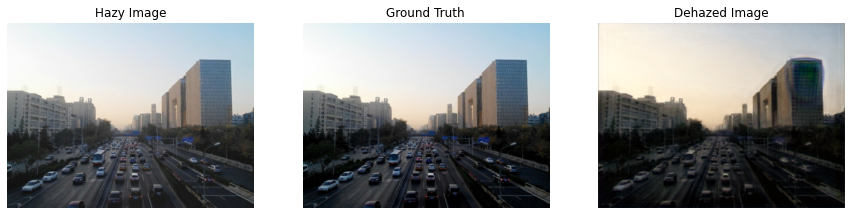

  -  Validation Loss: 0.2894  -   Time taken: 85.67s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 58 [==]  -  Training Loss: 0.0040

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


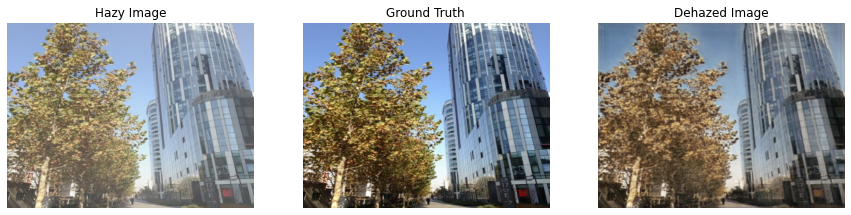

  -  Validation Loss: 0.2902  -   Time taken: 85.73s
INFO:tensorflow:Assets written to: trained_model/assets

Start of epoch 59 [==]  -  Training Loss: 0.0040

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


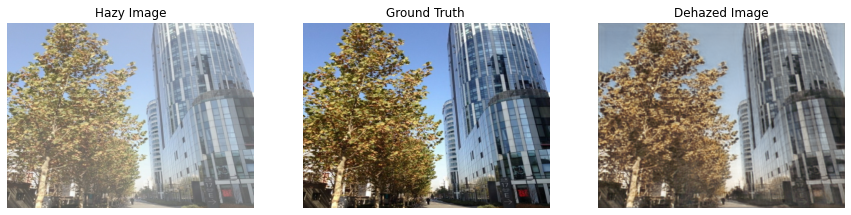

  -  Validation Loss: 0.2893  -   Time taken: 85.78s
INFO:tensorflow:Assets written to: trained_model/assets
CPU times: user 44min 9s, sys: 13min 7s, total: 57min 17s
Wall time: 1h 33min 9s


In [16]:
%%time
train_model(epochs, train, val, net, train_loss_tracker, val_loss_tracker, optimizer)

In [18]:
net.save('GCAmodel.tf')

INFO:tensorflow:Assets written to: GCAmodel.tf/assets


## Learn

In [19]:
net.save_weights("GCAweights")

In [26]:
from google.colab import files
files.download("./GCAmodel.tf")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [23]:
ls

checkpoint  GCAmodel.tf/                    GCAweights.index  trained_model/
drive/      GCAweights.data-00000-of-00001  sample_data/


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class ShareSepConv(nn.Module):
    def __init__(self, kernel_size):
        super(ShareSepConv, self).__init__()
        assert kernel_size % 2 == 1, 'kernel size should be odd'
        self.padding = (kernel_size - 1)//2
        weight_tensor = torch.zeros(1, 1, kernel_size, kernel_size)
        weight_tensor[0, 0, (kernel_size-1)//2, (kernel_size-1)//2] = 1
        self.weight = nn.Parameter(weight_tensor)
        self.kernel_size = kernel_size

    def forward(self, x):
        inc = x.size(1)
        expand_weight = self.weight.expand(inc, 1, self.kernel_size, self.kernel_size).contiguous()
        return F.conv2d(x, expand_weight,
                        None, 1, self.padding, 1, inc)


class SmoothDilatedResidualBlock(nn.Module):
    def __init__(self, channel_num, dilation=1, group=1):
        super(SmoothDilatedResidualBlock, self).__init__()
        self.pre_conv1 = ShareSepConv(dilation*2-1)
        self.conv1 = nn.Conv2d(channel_num, channel_num, 3, 1, padding=dilation, dilation=dilation, groups=group, bias=False)
        self.norm1 = nn.InstanceNorm2d(channel_num, affine=True)
        self.pre_conv2 = ShareSepConv(dilation*2-1)
        self.conv2 = nn.Conv2d(channel_num, channel_num, 3, 1, padding=dilation, dilation=dilation, groups=group, bias=False)
        self.norm2 = nn.InstanceNorm2d(channel_num, affine=True)

    def forward(self, x):
        y = F.relu(self.norm1(self.conv1(self.pre_conv1(x))))
        y = self.norm2(self.conv2(self.pre_conv2(y)))
        return F.relu(x+y)


class ResidualBlock(nn.Module):
    def __init__(self, channel_num, dilation=1, group=1):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channel_num, channel_num, 3, 1, padding=dilation, dilation=dilation, groups=group, bias=False)
        self.norm1 = nn.InstanceNorm2d(channel_num, affine=True)
        self.conv2 = nn.Conv2d(channel_num, channel_num, 3, 1, padding=dilation, dilation=dilation, groups=group, bias=False)
        self.norm2 = nn.InstanceNorm2d(channel_num, affine=True)

    def forward(self, x):
        y = F.relu(self.norm1(self.conv1(x)))
        y = self.norm2(self.conv2(y))
        return F.relu(x+y)


class GCANet(nn.Module):
    def __init__(self, in_c=3, out_c=3, only_residual=True):
        super(GCANet, self).__init__()
        self.conv1 = nn.Conv2d(in_c, 64, 3, 1, 1, bias=False)
        self.norm1 = nn.InstanceNorm2d(64, affine=True)
        self.conv2 = nn.Conv2d(64, 64, 3, 1, 1, bias=False)
        self.norm2 = nn.InstanceNorm2d(64, affine=True)
        self.conv3 = nn.Conv2d(64, 64, 3, 2, 1, bias=False)
        self.norm3 = nn.InstanceNorm2d(64, affine=True)

        self.res1 = SmoothDilatedResidualBlock(64, dilation=2)
        self.res2 = SmoothDilatedResidualBlock(64, dilation=2)
        self.res3 = SmoothDilatedResidualBlock(64, dilation=2)
        self.res4 = SmoothDilatedResidualBlock(64, dilation=4)
        self.res5 = SmoothDilatedResidualBlock(64, dilation=4)
        self.res6 = SmoothDilatedResidualBlock(64, dilation=4)
        self.res7 = ResidualBlock(64, dilation=1)

        self.gate = nn.Conv2d(64 * 3, 3, 3, 1, 1, bias=True)

        self.deconv3 = nn.ConvTranspose2d(64, 64, 4, 2, 1)
        self.norm4 = nn.InstanceNorm2d(64, affine=True)
        self.deconv2 = nn.Conv2d(64, 64, 3, 1, 1)
        self.norm5 = nn.InstanceNorm2d(64, affine=True)
        self.deconv1 = nn.Conv2d(64, out_c, 1)
        self.only_residual = only_residual

    def forward(self, x):
        y = F.relu(self.norm1(self.conv1(x)))
        y = F.relu(self.norm2(self.conv2(y)))
        y1 = F.relu(self.norm3(self.conv3(y)))

        y = self.res1(y1)
        y = self.res2(y)
        y = self.res3(y)
        y2 = self.res4(y)
        y = self.res5(y2)
        y = self.res6(y)
        y3 = self.res7(y)
        g=torch.cat((y1, y2, y3), dim=1)
        gates = self.gate(g)
        #return gates
        gated_y = y1 * gates[:, [0], :, :] + y2 * gates[:, [1], :, :] + y3 * gates[:, [2], :, :]
        return gated_y
        y = F.relu(self.norm4(self.deconv3(gated_y)))
        y = F.relu(self.norm5(self.deconv2(y)))
        if self.only_residual:
            y = self.deconv1(y)
        else:
            y = F.relu(self.deconv1(y))

        return y

In [ ]:
from torchsummary import summary
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = GCANet().to(device)
summary(model, (3, 412, 548))



----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 412, 548]           1,728
    InstanceNorm2d-2         [-1, 64, 412, 548]             128
            Conv2d-3         [-1, 64, 412, 548]          36,864
    InstanceNorm2d-4         [-1, 64, 412, 548]             128
            Conv2d-5         [-1, 64, 206, 274]          36,864
    InstanceNorm2d-6         [-1, 64, 206, 274]             128
      ShareSepConv-7         [-1, 64, 206, 274]               9
            Conv2d-8         [-1, 64, 206, 274]          36,864
    InstanceNorm2d-9         [-1, 64, 206, 274]             128
     ShareSepConv-10         [-1, 64, 206, 274]               9
           Conv2d-11         [-1, 64, 206, 274]          36,864
   InstanceNorm2d-12         [-1, 64, 206, 274]             128
SmoothDilatedResidualBlock-13         [-1, 64, 206, 274]               0
     ShareSepConv-14         [

In [ ]:
torch.randn(8,4,3,3).shape


torch.Size([8, 4, 3, 3])

In [ ]:
inc = x.size(1)
expand_weight = self.weight.expand(inc, 1, 1,1).contiguous()

NameError: ignored

In [ ]:
ar=np.random.rand(10,10,3)

In [ ]:
ar.shape

(10, 10, 3)

In [ ]:
ar[:][:][1]

array([[0.00478737, 0.97599354, 0.58389508],
       [0.48605498, 0.58289552, 0.51852247],
       [0.77013648, 0.91927876, 0.29976513],
       [0.2330718 , 0.93249402, 0.8699333 ],
       [0.50810366, 0.22091131, 0.59270627],
       [0.69180602, 0.6672283 , 0.98755119],
       [0.85092117, 0.46199479, 0.06967033],
       [0.47253204, 0.58168146, 0.19953804],
       [0.1610528 , 0.63965034, 0.07386533],
       [0.53019948, 0.06096521, 0.35931462]])

In [ ]:
import numpy as np

In [ ]:
ker=np.eye(30,30)

In [ ]:
img=np.random.rand(8,30,30,3)

In [ ]:
a=ker*img

ValueError: ignored

In [ ]:
a.shape

(8, 30, 30)

In [ ]:
img1=np.random.rand(8,30,30,3)

In [ ]:
b1=ker*img1[:,:,:,0]

In [ ]:
b2=ker*img1[:,:,:,1]

In [ ]:
b3=ker*img1[:,:,:,2]

In [ ]:
b1.shape

(8, 30, 30)

In [ ]:
np.stack((b1,b2,b3),axis=-1).shape

(8, 30, 30, 3)

In [ ]:
ker1=tf.broadcast_to(tf.expand_dims(ker,-1),[,,3])

SyntaxError: ignored

In [ ]:
n=ker1*img1

In [ ]:
n.shape

TensorShape([8, 30, 30, 3])